# RNA-Binders CDD Project
## Author: Jozef Fulop
### Date: 05/18/2023
### Description

This Jupyter Notebook titled "RNA-Binders" presents an analysis of RNA-targeting small molecules. The notebook explores various aspects related to RNA-targeting compounds. The analysis aims to provide insights into the field of RNA-targeting small molecules.

# Import libraries

In [1]:
import os
import numpy as np
from zipfile import ZipFile
from io import BytesIO
from rdkit import Chem
import pandas as pd
from rdkit.Chem import AllChem
from chembl_structure_pipeline import standardizer
from rdkit import DataStructs
from rdkit import Chem, SimDivFilters
from rdkit.Chem import Draw
# descriptors
from rdkit.Chem import Lipinski
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import Descriptors

from sklearn.manifold import TSNE
import umap

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import display

from rdkit import RDLogger
RDLogger.DisableLog('rdApp.error')

[11:18:22] Initializing Normalizer


# Load data 

In [2]:
# create folder data for the data files
if not os.path.exists('data'):
    os.makedirs('data')

# original links if needed, when my links are not working
"""
https://enamine.net/compound-libraries/diversity-libraries/hit-locator-library-200
https://figshare.com/articles/dataset/Machine_Learning_Informs_RNA-Binding_Chemical_Space/20401974
https://lifechemicals.com/screening-libraries/targeted-and-focused-screening-libraries/rna-focused-library
https://www.chemdiv.com/catalog/focused-and-targeted-libraries/mirna-library/#
"""
# fetch data using wget and store it in the data folder
# list of tuples containing zip filename and download link
zip_files = [
    ('chemdiv_miRNA.zip', 'https://owncloud.cesnet.cz/index.php/s/upiQUlIqMnAgYAg/download'),
    ('life_chemicals.zip', 'https://owncloud.cesnet.cz/index.php/s/g5BmDxsUMmMXSW9/download'),
    ('robin.zip', 'https://owncloud.cesnet.cz/index.php/s/1SxoqXhD55vzZzS/download'),
    ('enamine_rna.zip', 'https://owncloud.cesnet.cz/index.php/s/RD1T0YyYAAEUdlz/download'),
    ('enamine_protein.zip', 'https://owncloud.cesnet.cz/index.php/s/DpfKEZ9HbrEVLBQ/download')
]

# download zip files if not already in data folder
for zip_file, url in zip_files:
    if not os.path.exists(f'data/{zip_file}'):
        !wget -O data/{zip_file} {url}     
    
#####################################################################

def read_sdf_from_zip(zip_path, sdf_file_path):
    with ZipFile(zip_path, 'r') as zip_file:
        sdf_file = zip_file.read(sdf_file_path)
    sdf_file = BytesIO(sdf_file)
    supplier = Chem.SDMolSupplier()
    supplier.SetData(sdf_file.read().decode('utf-8'))
    mols = [mol for mol in supplier if mol is not None]
    df = pd.DataFrame(mols)
    return df

chemdiv_df = read_sdf_from_zip('data/chemdiv_miRNA.zip', 'library_miR_25102022/library_miRNA_props.sdf')
life_chemicals_df = read_sdf_from_zip('data/life_chemicals.zip', 'LC_RNA_Focused_Library.sdf')
enamine_rna_df = read_sdf_from_zip('data/enamine_rna.zip', 'Enamine_RNA_Library_2021_plated_15520cmds_20210302.sdf')
enamine_protein_df = read_sdf_from_zip('data/enamine_protein.zip', 'Enamine_Hit_Locator_Library_HLL-460_460160cmpds_20220221.sdf')
robin_df = read_sdf_from_zip('data/robin.zip', 'data/SDF_files/ROBIN_RNA_Binders_3D.sdf')


In [3]:
datasets = [chemdiv_df, life_chemicals_df, robin_df, enamine_rna_df, enamine_protein_df]

# for all dataset rename the column from 0 to mol
for df in datasets:
    df.rename(columns={0: 'mol'}, inplace=True)
    
    
# create copies from all datasets, just in case
chemdiv_df_copy = chemdiv_df.copy()
life_chemicals_df_copy = life_chemicals_df.copy()
enamine_rna_df_copy = enamine_rna_df.copy()
enamine_protein_df_copy = enamine_protein_df.copy()
robin_df_copy = robin_df.copy()


In [4]:

def generate_2d_coords(mol):
    mol_2d = Chem.Mol(mol)  # Create a copy of the molecule
    AllChem.Compute2DCoords(mol_2d)
    return mol_2d

# Define the standardize_mol function
def standardize_mol(mol):
    """Standardize molecule."""
    mol = standardizer.standardize_mol(mol)
    return mol

In [5]:
# calculate 2D coordinates for ROBIN lib. because it is in 3D
robin_df_copy['mol'] = robin_df_copy['mol'].apply(generate_2d_coords)


# Standardization using ChEMBL pipeline

In [6]:
# Standardize all datasets without displaying the output
chemdiv_df_copy['mol'] = chemdiv_df_copy['mol'].apply(lambda mol: standardize_mol(mol))
life_chemicals_df_copy['mol'] = life_chemicals_df_copy['mol'].apply(lambda mol: standardize_mol(mol))
enamine_rna_df_copy['mol'] = enamine_rna_df_copy['mol'].apply(lambda mol: standardize_mol(mol))
enamine_protein_df_copy['mol'] = enamine_protein_df_copy['mol'].apply(lambda mol: standardize_mol(mol))
robin_df_copy['mol'] = robin_df_copy['mol'].apply(lambda mol: standardize_mol(mol))


[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:52] Running Normalizer
[15:51:52] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharger
[15:51:53] Running Normalizer
[15:51:53] Running Uncharg

In [7]:
datasets_copy = [chemdiv_df_copy, life_chemicals_df_copy, robin_df_copy, enamine_rna_df_copy, enamine_protein_df_copy]

In [8]:
# create a column fp and calculate ECFP3 fingerprints for all datasets
for df in datasets_copy:
    df['fp3'] = df['mol'].apply(AllChem.GetMorganFingerprintAsBitVect, args=(3, 2048))

In [9]:
# create a folder subset8K for the 8K subset
if not os.path.exists('subset8K_project'):
    os.makedirs('subset8K_project')

# Diversity picking - subsampling


In [10]:
def pick_8K_subset(df, filename):
    fps = df['fp3'].values
    mmp = SimDivFilters.MaxMinPicker()
    picks = mmp.LazyBitVectorPick(fps, len(fps), 8000, seed=23)
    picked_df = df.iloc[picks]
    picked_df.to_pickle(f'subset8K_project/{filename}_8K_ECFP6.pkl')

In [11]:
def pick_2K_subset_ECFP6(df, filename):
    fps = df['fp3'].values
    mmp = SimDivFilters.MaxMinPicker()
    picks = mmp.LazyBitVectorPick(fps, len(fps), 2000, seed=23)
    picked_df = df.iloc[picks]
    picked_df.to_pickle(f'subset8K_project/{filename}_2K_ECFP6.pkl')

In [12]:
# use diversity picking to select 2003 molecules from rna datasets
for df, filename in zip(datasets_copy, ['chemdiv', 'life_chemicals', 'robin', 'enamine_rna']):
    pick_2K_subset_ECFP6(df, filename)

In [13]:
# use diversity picking to select 8K molecules from concatenated dataset and for protein dataset
prot_df = enamine_protein_df_copy
pick_8K_subset(prot_df, 'protein')

In [2]:
# load 8K subset for rna and protein
protein_8K = pd.read_pickle('subset8K_project/protein_8K_ECFP6.pkl')
# read rna datasets
chemdiv_8K = pd.read_pickle('subset8K_project/chemdiv_2K_ECFP6.pkl')
enamine_8K = pd.read_pickle('subset8K_project/enamine_rna_2K_ECFP6.pkl')
life_chemicals_8K = pd.read_pickle('subset8K_project/life_chemicals_2K_ECFP6.pkl')
robin_8K = pd.read_pickle('subset8K_project/robin_2K_ECFP6.pkl')


In [3]:
# add source column to the 2K subsets
chemdiv_8K['source'] = 'chemdiv'
life_chemicals_8K['source'] = 'life_chemicals'
robin_8K['source'] = 'robin'
enamine_8K['source'] = 'enamine_rna'
protein_8K['source'] = 'enamine_protein'

In [4]:
# concatenate the dataframes ['chemdiv_8K', 'enamine_8K', 'life_chemicals_8K', 'robin_2K']
rna_df = pd.concat([chemdiv_8K, enamine_8K, life_chemicals_8K, robin_8K], ignore_index=True)
# add column 'RNA binding' to rna_df and fill with 1
rna_df['RNA binding'] = 1
prot_df = pd.read_pickle('subset8K_project/protein_8K_ECFP6.pkl')
# add column 'RNA binding' to prot_df and fill with 0
prot_df['RNA binding'] = 0
all_df_8K_ECFP6 = pd.concat([rna_df, prot_df], ignore_index=True)


In [17]:
# save the 8K subset
all_df_8K_ECFP6.to_pickle('subset8K_project/all_df_8K_ECFP6.pkl')

In [18]:
all_df_8K_ECFP6.head()

,mol,fp3,source,RNA binding
0,<rdkit.Chem.rdchem.Mol object at 0x7f198ccb7d80>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
1,<rdkit.Chem.rdchem.Mol object at 0x7f198ccb5990>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
2,<rdkit.Chem.rdchem.Mol object at 0x7f198869b1f0>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
3,<rdkit.Chem.rdchem.Mol object at 0x7f198869a930>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
4,<rdkit.Chem.rdchem.Mol object at 0x7f198869ad90>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1


Similarity matrix

In [5]:
# change NaN values in column 'source' to 'protein_enamine'
all_df_8K_ECFP6['source'] = all_df_8K_ECFP6['source'].fillna('protein_enamine')

In [20]:
all_df_8K_ECFP6.head()

,mol,fp3,source,RNA binding
0,<rdkit.Chem.rdchem.Mol object at 0x7f198ccb7d80>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
1,<rdkit.Chem.rdchem.Mol object at 0x7f198ccb5990>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
2,<rdkit.Chem.rdchem.Mol object at 0x7f198869b1f0>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
3,<rdkit.Chem.rdchem.Mol object at 0x7f198869a930>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1
4,<rdkit.Chem.rdchem.Mol object at 0x7f198869ad90>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",chemdiv,1


In [21]:
# create a similarity matrix for the 2K subset and store it in a similarity_matrix_2K padas dataframe
def create_similarity_matrix(df):
    fps = df['fp3'].values
    n = df.shape[0]
    similarity_matrix = np.zeros((n,n))
   
    print("Starting similarity matrix creation...")
    
    for i in range(n):
        if i == n // 2:
            print("Halfway through similarity matrix creation...")
        
        for j in range(i, n):
            similarity_matrix[i,j] = DataStructs.TanimotoSimilarity(df.fp3[i], df.fp3[j])
            similarity_matrix[j,i] = similarity_matrix[i,j]
    
    print("Similarity matrix creation completed!")
    
    similarity_matrix_8K = pd.DataFrame(similarity_matrix)
    return similarity_matrix_8K


In [22]:
# if in data/ is not similarity_matrix_8K.pkl, create it if yes load it from data/
if not os.path.exists('data/similarity_matrix_8K.pkl'):
    similarity_matrix_8K = create_similarity_matrix(all_df_8K_ECFP6)
    similarity_matrix_8K.to_pickle('data/similarity_matrix_8K.pkl')
else:
    similarity_matrix_8K = pd.read_pickle('data/similarity_matrix_8K.pkl')

In [23]:
similarity_matrix_8K.head()

,0,1,2,3,4,5,6,7,8,9,...,15990,15991,15992,15993,15994,15995,15996,15997,15998,15999
0,1.000000,0.026316,0.036364,0.040000,0.039683,0.050420,0.058333,0.049296,0.048951,0.065574,...,0.062992,0.062992,0.061538,0.062992,0.074074,0.096000,0.111111,0.112000,0.097015,0.073770
1,0.026316,1.000000,0.017857,0.042857,0.042254,0.046154,0.044776,0.045455,0.056818,0.029851,...,0.114286,0.068493,0.094595,0.114286,0.173333,0.095890,0.050633,0.051282,0.071429,0.057143
2,0.036364,0.017857,1.000000,0.029412,0.044118,0.048387,0.000000,0.011364,0.000000,0.046512,...,0.013514,0.086957,0.054054,0.041667,0.011905,0.013158,0.052632,0.039474,0.074074,0.075758
3,0.040000,0.042857,0.029412,1.000000,0.035714,0.025316,0.037500,0.029412,0.060000,0.041379,...,0.070588,0.058140,0.080460,0.083333,0.074468,0.056818,0.043478,0.067416,0.072917,0.074074
4,0.039683,0.042254,0.044118,0.035714,1.000000,0.025000,0.050000,0.060000,0.049020,0.020134,...,0.033708,0.033708,0.079545,0.057471,0.073684,0.044444,0.043011,0.116279,0.019608,0.011494


In [24]:
similarity_matrix_8K.shape

(16000, 16000)

In [25]:
# from similarity_matrix_2K calculate the distance matrix
distance_matrix_8K = 1 - similarity_matrix_8K


In [26]:
# add source column to the distance matrix to the start of the dataframe
distance_matrix_8K.insert(0, 'source', all_df_8K_ECFP6['source'])

In [27]:

# if in column is chemdiv, life_chemicals, robin, enamine_rna add column RNA, if enamine_protein add column protein
distance_matrix_8K['RNA/Protein'] = np.where(distance_matrix_8K['source'].isin(['chemdiv', 'life_chemicals', 'robin', 'enamine_rna']), 'RNA', 'Protein')
# put the 'RNA/Protein' column to the 0th position
col_binding = distance_matrix_8K.pop('RNA/Protein')
distance_matrix_8K.insert(0, 'RNA/Protein', col_binding)


In [28]:
# shuffle random distance_matrix_8K
distance_matrix_8K = distance_matrix_8K.sample(frac=1).reset_index(drop=True)  #

# Dimensionality reduction
t-SNE and UMAP

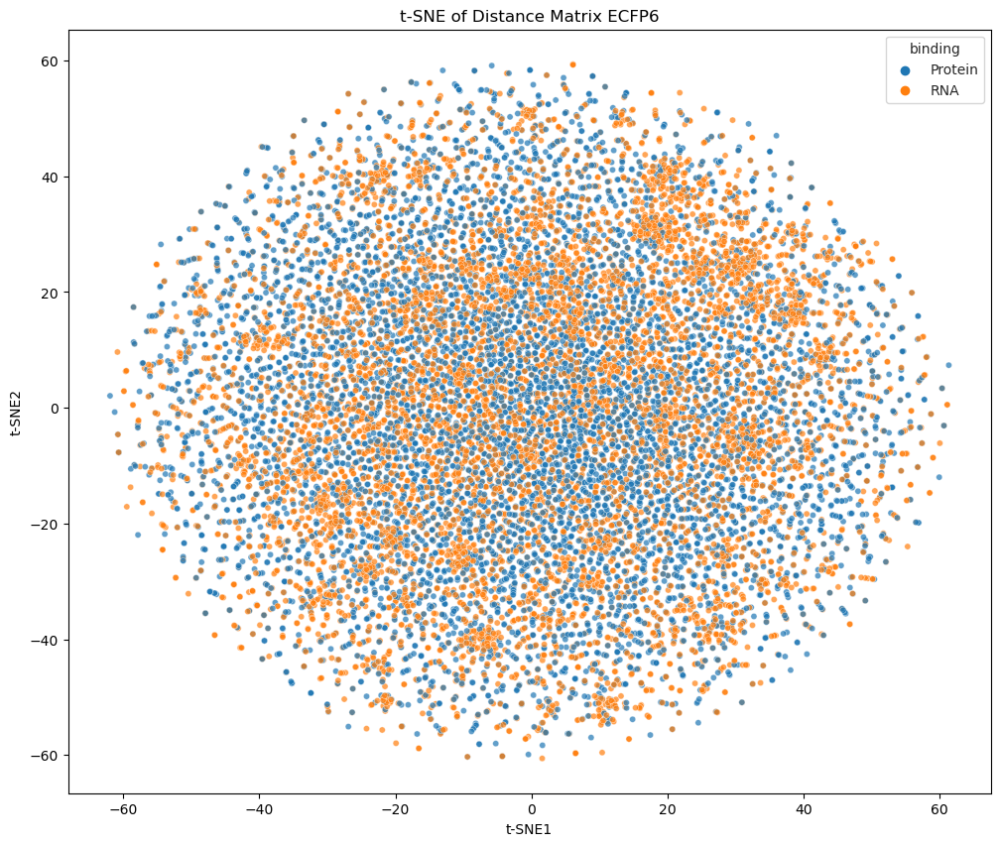

In [29]:
tsne = TSNE(n_components=2, n_jobs=-1, metric="precomputed", init="random", random_state=42)
tsne_data = tsne.fit_transform(distance_matrix_8K.iloc[:, 2:]) # we don't need the first two columns, because they are not numeric
tsne_data = pd.DataFrame(tsne_data, columns=['t-SNE1', 't-SNE2'])
tsne_data['binding'] = distance_matrix_8K['RNA/Protein'].astype(str)

# plot first two components
fig, ax = plt.subplots(1, 1, figsize=(12, 10))
sns.set_style("whitegrid")
sns.scatterplot(x='t-SNE1', y='t-SNE2', hue='binding', data=tsne_data, alpha=0.7, s=20)
ax.title.set_text('t-SNE of Distance Matrix ECFP6')
plt.show()



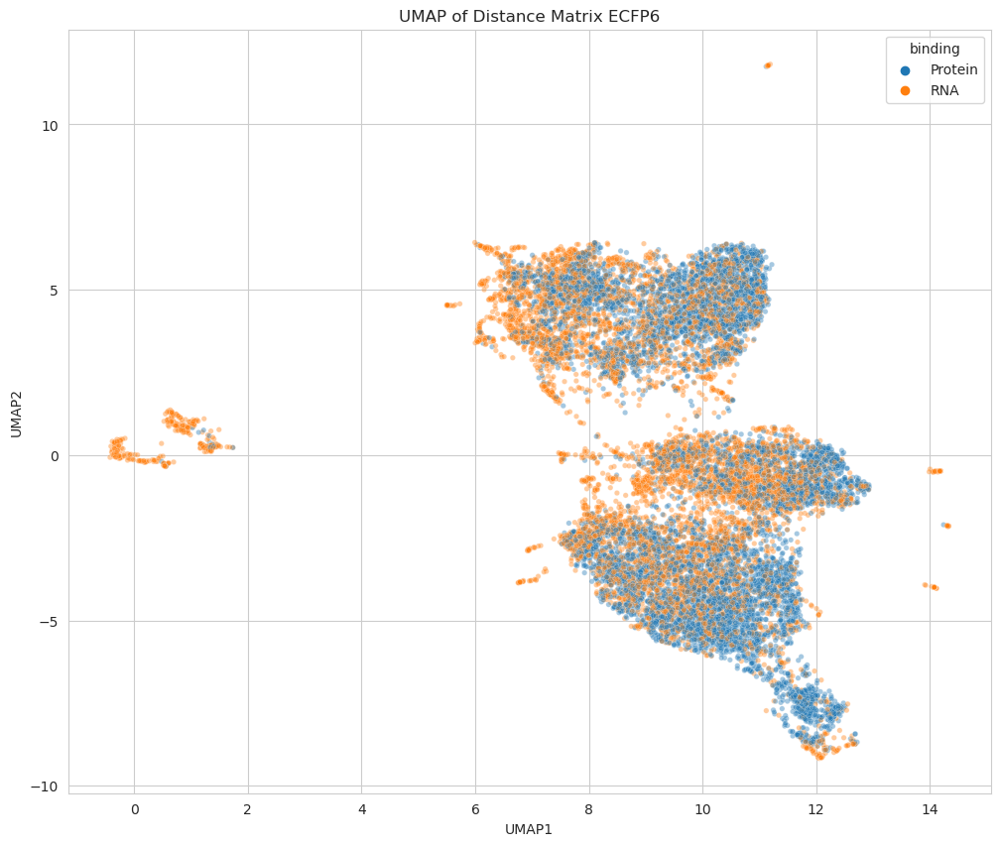

In [30]:
umap_model = umap.UMAP(n_components=2, n_jobs=-1, random_state=42)
umap_data = umap_model.fit_transform(distance_matrix_8K.iloc[:, 2:]) # we don't need the first two columns, because they are not numeric
umap_data = pd.DataFrame(umap_data, columns=['UMAP1', 'UMAP2'])
umap_data['binding'] = distance_matrix_8K['RNA/Protein'].astype(str)


fig, ax = plt.subplots(1, 1, figsize=(12, 10))
sns.set_style("whitegrid")
sns.scatterplot(x='UMAP1', y='UMAP2', hue='binding', data=umap_data, alpha=0.4, s=15)
ax.title.set_text('UMAP of Distance Matrix ECFP6')
plt.show()



# Lipinski rule of 5 

This code applies Lipinski's rule of five to a dataset of molecules and counts the number of rule violations for each source of data. Lipinski's rule of five is a rule of thumb in medicinal chemistry for evaluating druglikeness or determining if a chemical compound with a certain pharmacological or biological activity has chemical properties and physical properties that would make it a likely orally active drug in humans. 

The rule describes molecular properties important for a drug's pharmacokinetics in the human body, including their absorption, distribution, metabolism, and excretion ("ADME"). The rule is based on the observation that most medication drugs have a molecular weight under 500 daltons, have fewer than 5 hydrogen bond donors, have fewer than 10 hydrogen bond acceptors, and have an octanol-water partition coefficient (log P) less than 5.

The plot visualizes the number of Lipinski violations across different sources of data, showing how many molecules in each source violate zero, one, two, three, or more of these rules. This allows for a comparison of drug-likeness or suitability for oral administration across the different sources.

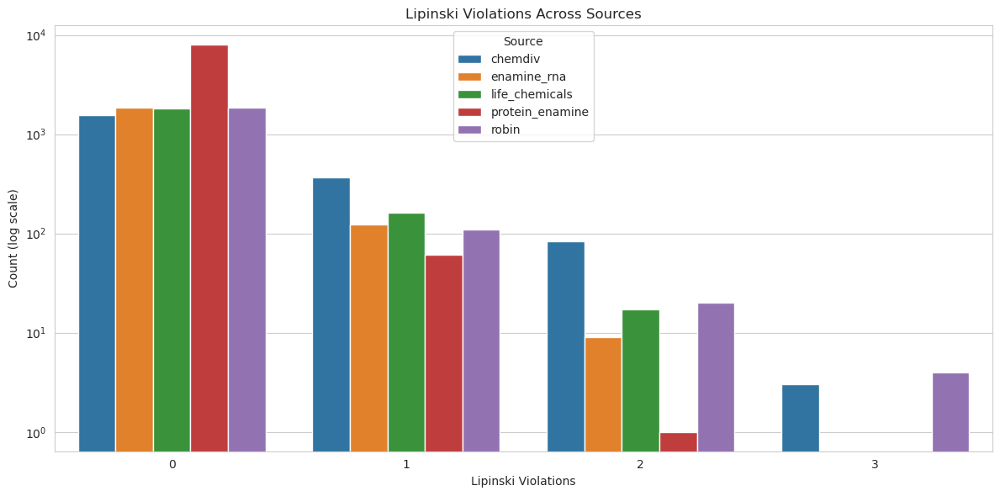

In [31]:

# Create Lipinski filter function to filter out molecules that fail the Lipinski rule of 5
# MW < 500, HBA < 10, HBD < 5, RB < 10, logP < 5

def lipinski_filter(mol_list):
    """Apply Lipinski's rule of 5 to a list of molecules.

    Args:
        mol_list (list): List of RDKit molecules.

    Returns:
        list: List of rule violations (count of violations for each molecule).
    """
    violations = []
    for mol in mol_list:
        violation = 0
        if mol is None:
            violations.append(violation)
            continue

        if Descriptors.MolWt(mol) > 500:
            violation += 1
        if Descriptors.NumHAcceptors(mol) > 10:
            violation += 1
        if Descriptors.NumHDonors(mol) > 5:
            violation += 1
        if Descriptors.MolLogP(mol) > 5:
            violation += 1

        violations.append(violation)
    return violations

# Create a new column "Lipinski Violations" and apply lipinski_filter function for each source separately
all_df_8K_ECFP6['Lipinski Violations'] = all_df_8K_ECFP6.groupby('source')['mol'].transform(lipinski_filter)

# Count the number of molecules that pass the Lipinski filter for each source and Lipinski Violations
lipinski_count = all_df_8K_ECFP6.groupby(['source', 'Lipinski Violations']).size().reset_index(name='Count')

# Create bar plot for the number of molecules that pass the Lipinski filter, combining all sources
plt.figure(figsize=(12, 6))
sns.barplot(x='Lipinski Violations', y='Count', hue='source', data=lipinski_count)
plt.title('Lipinski Violations Across Sources')
plt.xlabel('Lipinski Violations')
plt.ylabel('Count (log scale)')
plt.yscale('log')
plt.legend(title='Source')
plt.tight_layout()
plt.show()


# Scaffold analysis


Here the code extracts and visualizes the top five most common Murcko and CSK scaffolds for each source in a given dataset. It begins by generating the Murcko and CSK scaffolds for each molecule in the dataset. These scaffolds are then counted and sorted by their occurrence. The top five scaffolds for each source are then selected and their ratios to the total number of unique scaffolds are calculated. Finally, these top five scaffolds are visualized in a grid format for each scaffold type (Murcko and CSK) with their respective source, count, and ratio information.

In [32]:
from rdkit.Chem.Scaffolds import MurckoScaffold

def get_murcko_scaffold(mol):
    try:
        scaffold = MurckoScaffold.GetScaffoldForMol(mol)
        scaffold = Chem.MolToSmiles(scaffold)
    except ValueError:
        scaffold = ""
    return scaffold

def get_csk_scaffold(mol):
    try:
        scaffold = MurckoScaffold.GetScaffoldForMol(mol)
        scaffold = MurckoScaffold.MakeScaffoldGeneric(scaffold)
        scaffold = Chem.MolToSmiles(scaffold)
    except ValueError:
        scaffold = ""
    return scaffold
# add column with Murcko scaffold to all_df_8K_ECFP6
all_df_8K_ECFP6['Murcko Scaffold'] = all_df_8K_ECFP6['mol'].apply(get_murcko_scaffold)
# add column with CSK scaffold to all_df_8K_ECFP6
all_df_8K_ECFP6['CSK Scaffold'] = all_df_8K_ECFP6['mol'].apply(get_csk_scaffold)

# count murcko scaffold occurences for each source
murcko_scaffold_count = all_df_8K_ECFP6.groupby(['source', 'Murcko Scaffold']).size().reset_index(name='Count')
# count csk scaffold occurences for each source
csk_scaffold_count = all_df_8K_ECFP6.groupby(['source', 'CSK Scaffold']).size().reset_index(name='Count')

# sort musrcko and csk scaffold count by count
murcko_scaffold_count = murcko_scaffold_count.sort_values(by='Count', ascending=False)
csk_scaffold_count = csk_scaffold_count.sort_values(by='Count', ascending=False)
# top 5 murcko scaffold for each source
top_5_murcko_scaffold = murcko_scaffold_count.groupby('source').head(5).sort_values(by='source', ascending=False)

# top 5 csk scaffold for each source and sorc them by source
top_5_csk_scaffold = csk_scaffold_count.groupby('source').head(5).sort_values(by='source', ascending=False)

# compute number of unique murcko scaffolds for each source
unique_murcko_scaffolds_sum = pd.DataFrame(murcko_scaffold_count.groupby('source').size().reset_index(name='Count'))
unique_csk_scaffolds_sum = pd.DataFrame(csk_scaffold_count.groupby('source').size().reset_index(name='Count'))

unique_murcko_scaffolds_dict = unique_murcko_scaffolds_sum.set_index('source')['Count'].to_dict()
unique_csk_scaffolds_dict = unique_csk_scaffolds_sum.set_index('source')['Count'].to_dict()

top_5_murcko_scaffold['Ratio'] = top_5_murcko_scaffold.apply(lambda row: row['Count'] / unique_murcko_scaffolds_dict[row['source']], axis=1)
top_5_csk_scaffold['Ratio'] = top_5_csk_scaffold.apply(lambda row: row['Count'] / unique_csk_scaffolds_dict[row['source']], axis=1)

top_5_murcko_scaffold = top_5_murcko_scaffold.sort_values(by=['source', 'Ratio'], ascending=False)
top_5_csk_scaffold = top_5_csk_scaffold.sort_values(by=['source', 'Ratio'], ascending=False)

img_ls_mrc = Draw.MolsToGridImage(
    [Chem.MolFromSmiles(smi) for smi in top_5_murcko_scaffold['Murcko Scaffold']], 
    molsPerRow=5, 
    subImgSize=(300, 150), 
    legends=[
        f"{row['source']}, Count: {row['Count']} Ratio: {row['Ratio']:.5f}" 
        for _, row in top_5_murcko_scaffold.iterrows()
    ]
)

img_ls_csk = Draw.MolsToGridImage(
    [Chem.MolFromSmiles(smi) for smi in top_5_csk_scaffold['CSK Scaffold']], 
    molsPerRow=5, 
    subImgSize=(300, 150), 
    legends=[
        f"{row['source']}, Count: {row['Count']} Ratio: {row['Ratio']:.5f}" 
        for _, row in top_5_csk_scaffold.iterrows()
    ]
)


The 'ratio' column represents the proportion of each scaffold's count within a specific dataset (or source) relative to the total count of all scaffolds in that dataset.

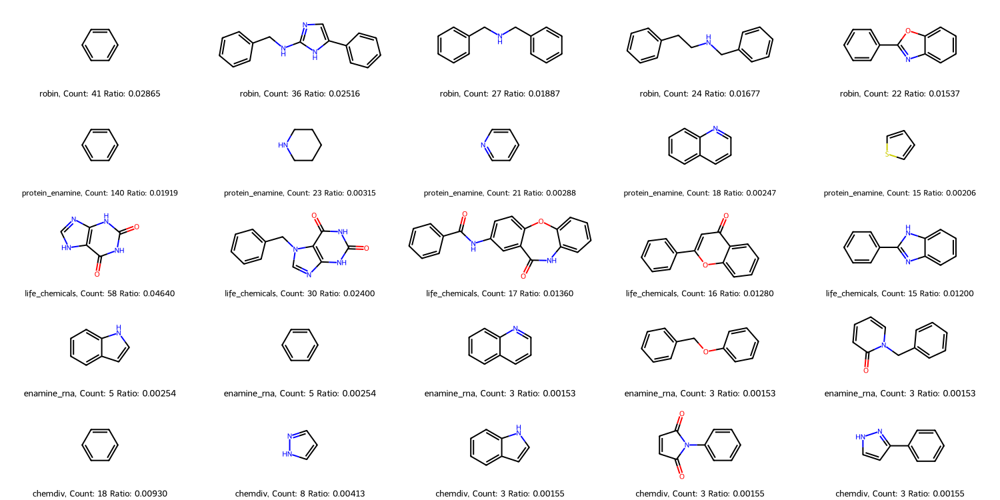

In [33]:
img_ls_mrc

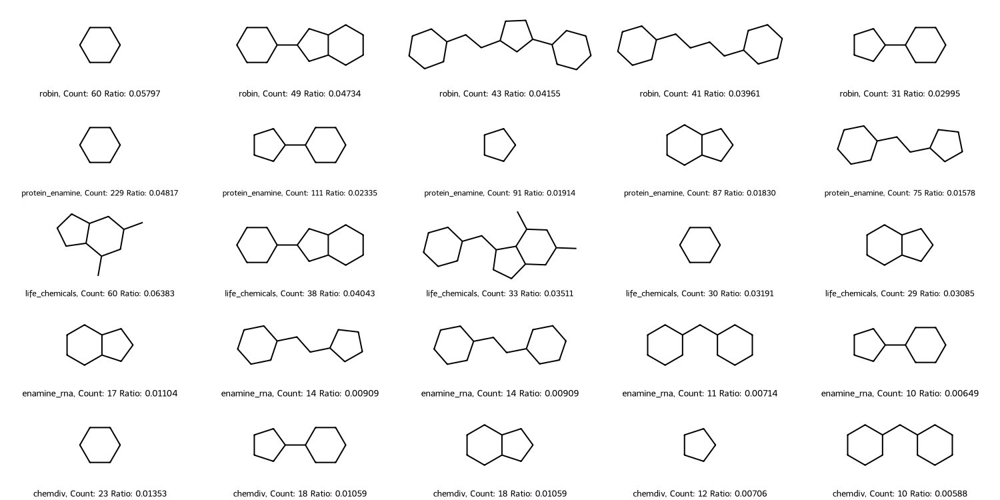

In [34]:
img_ls_csk

# Machine learning clasification using ECFP3 and SMILES

Balanced 8K RNA to 8K Protein

In [6]:
# check for missing values
all_df_8K_ECFP6.isnull().sum()

mol            0
fp3            0
source         0
RNA binding    0
dtype: int64

This Python code below is used for predicting whether a molecule can bind to RNA based on its molecular fingerprint. It uses two machine learning models: Random Forest and LightGBM. The code optimizes the hyperparameters for both models using Bayesian Optimization, fits the models to the training data, and then makes predictions on the test data. The performance of the models is evaluated by calculating the Area Under the ROC Curve (AUC-ROC), and the ROC curves are then visualized in a plot.

The Random Forest model achieved an AUC of 0.761, and the LightGBM model achieved an AUC of 0.786. This indicates that both models had reasonable predictive power, with the LightGBM model performing slightly better than the Random Forest model in this specific task.

Random Forest AUC: 0.850
LightGBM AUC: 0.868


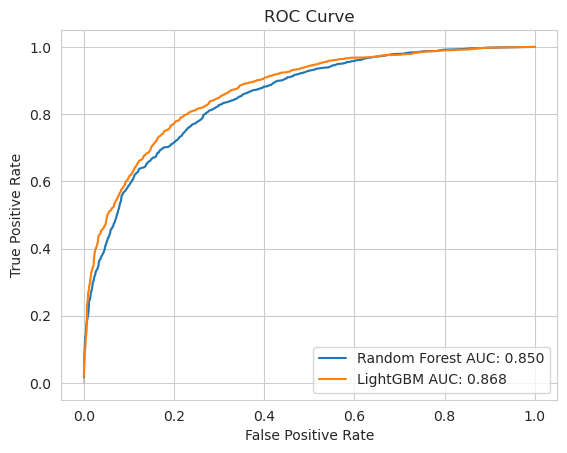

In [36]:
# load necessary modules
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from skopt import BayesSearchCV
import lightgbm as lgb
import numpy as np


# create X and y
X = np.array(all_df_8K_ECFP6['fp3'].tolist())
y = all_df_8K_ECFP6['RNA binding'].values

# split data with stratified sampling
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# create classifiers
rf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1, class_weight='balanced')
lgbm = lgb.LGBMClassifier(random_state=42, n_jobs=-1, class_weight='balanced')

# Defining a function to optimize
def optimize_model(model, params, X_train, y_train):
    opt = BayesSearchCV(model, params, n_iter=15, random_state=42)
    opt.fit(X_train, y_train)
    return opt.best_params_


rf_params = {'max_depth': (30, 54), 'min_samples_leaf': (5, 13), 'min_samples_split': (5, 13), 'n_estimators': (426, 526)}
lgbm_params = {'learning_rate': (0.15, 0.3), 'max_depth': (36, 56), 'n_estimators': (94, 134), 'num_leaves': (18, 28)}

# Run optimization
rf_best_params = optimize_model(rf, rf_params, X_train, y_train)
lgbm_best_params = optimize_model(lgbm, lgbm_params, X_train, y_train)

# Fit the models with best parameters
rf.set_params(**rf_best_params).fit(X_train, y_train)
lgbm.set_params(**lgbm_best_params).fit(X_train, y_train)

# Predict probabilities
y_pred_proba_rf = rf.predict_proba(X_test)[:, 1]  # probabilities for the positive outcome
y_pred_proba_lgbm = lgbm.predict_proba(X_test)[:, 1]  # probabilities for the positive outcome

# Calculate ROC curve
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_proba_rf)
fpr_lgbm, tpr_lgbm, _ = roc_curve(y_test, y_pred_proba_lgbm)

# Calculate AUC
auc_rf = auc(fpr_rf, tpr_rf)
auc_lgbm = auc(fpr_lgbm, tpr_lgbm)

# Print AUC
print(f'Random Forest AUC: {auc_rf:.3f}')
print(f'LightGBM AUC: {auc_lgbm:.3f}')

# visualize AUC
fig, ax = plt.subplots(1, 1)
sns.set_style("whitegrid")
sns.lineplot(x=fpr_rf, y=tpr_rf, label=f'Random Forest AUC: {auc_rf:.3f}')
sns.lineplot(x=fpr_lgbm, y=tpr_lgbm, label=f'LightGBM AUC: {auc_lgbm:.3f}')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()




This Python code uses the sklearn library to train a Multi-Layer Perceptron (MLP) classifier on a dataset for predicting RNA binding. The data is split into training and test sets, with the training data being scaled using a standard scaler. The MLP model's hyperparameters are tuned using a randomized search with cross-validation, with the aim of optimizing the area under the Receiver Operating Characteristic (ROC) curve (AUC). The best model is then used to predict on the test set and calculate the ROC curve. The resulting MLP classifier achieves an AUC of 0.788, which is a reasonable score indicating a good level of discriminative power. The ROC curve and AUC are then visualized using seaborn and matplotlib.

Iteration 1, loss = 0.83804937
Validation score: 0.500469
Iteration 2, loss = 0.83536279
Validation score: 0.500469
Iteration 3, loss = 0.83267999
Validation score: 0.499531
Iteration 4, loss = 0.83025733
Validation score: 0.499531
Iteration 5, loss = 0.82756405
Validation score: 0.500469
Iteration 6, loss = 0.82521043
Validation score: 0.499531
Iteration 7, loss = 0.82319001
Validation score: 0.647610
Iteration 8, loss = 0.82072694
Validation score: 0.499531
Iteration 9, loss = 0.81840091
Validation score: 0.694470
Iteration 10, loss = 0.81606301
Validation score: 0.500469
Iteration 11, loss = 0.81387232
Validation score: 0.500469
Iteration 12, loss = 0.81168096
Validation score: 0.499531
Iteration 13, loss = 0.80976389
Validation score: 0.499531
Iteration 14, loss = 0.80735175
Validation score: 0.500469
Iteration 15, loss = 0.80553626
Validation score: 0.500469
Iteration 16, loss = 0.80367091
Validation score: 0.502343
Iteration 17, loss = 0.80161524
Validation score: 0.499531
Iterat

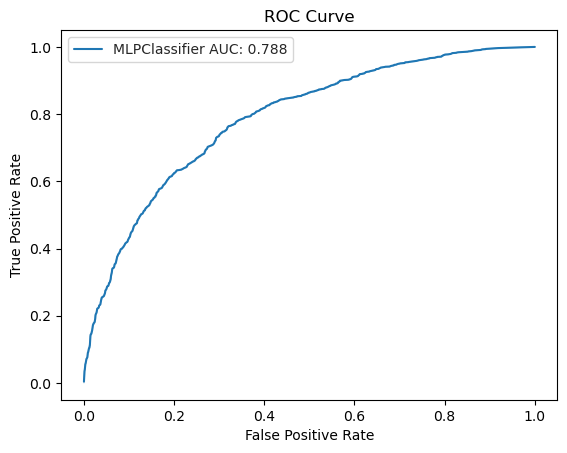

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.metrics import roc_curve, auc
from scipy.stats import uniform, randint

# Create X and y
X = np.array(all_df_8K_ECFP6['fp3'].tolist())
y = all_df_8K_ECFP6['RNA binding'].values

# Perform stratified train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Adjusted parameter grid
param_dist = {
    'hidden_layer_sizes': [(100, 100)],  # best value
    'activation': ['logistic'],  # best value
    'solver': ['sgd'],  # best value
    'alpha': uniform(loc=0.09, scale=0.02),  # around the best value alpha': [0.09, 0.1, 0.11]
    'learning_rate': ['adaptive'],  # best value
    'batch_size': randint(30, 35),  # around the best value 'batch_size': [30, 32, 35],
    'max_iter': randint(2900, 3100),  # around the best value 'max_iter': [2900, 3000, 3100],
    'early_stopping': [True],  # best value
}

# Create MLPClassifier instance with increased max_iter and verbose output
mlp = MLPClassifier(random_state=42, verbose=True)

# Perform grid search CV
random_search = RandomizedSearchCV(mlp, param_distributions=param_dist, n_iter=10, cv=3)
random_search.fit(X, y)

# Get the best MLPClassifier model
best_mlp = random_search.best_estimator_

# Predict using the best model
y_pred_proba_mlp = best_mlp.predict_proba(X_test)[:, 1]  # probabilities for the positive outcome

# Calculate ROC curve
fpr_mlp, tpr_mlp, _ = roc_curve(y_test, y_pred_proba_mlp)

# Calculate AUC
auc_mlp = auc(fpr_mlp, tpr_mlp)

# Print AUC
print(f'MLPClassifier AUC: {auc_mlp:.3f}')

# Visualize AUC
fig, ax = plt.subplots(1, 1)
sns.set_style("whitegrid")
sns.lineplot(x=fpr_mlp, y=tpr_mlp, label=f'MLPClassifier AUC: {auc_mlp:.3f}')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()


These were best parameters before adjusting new grid.

In [ ]:
print(f'Best parameters: {random_search.best_params_}')

Best parameters: {'solver': 'sgd', 'max_iter': 3000, 'learning_rate': 'adaptive', 'hidden_layer_sizes': (100, 100), 'early_stopping': True, 'batch_size': 32, 'alpha': 0.1, 'activation': 'logistic'}


Use papermill for running the notebook on background in terminal.

papermill input_notebook.ipynb output_notebook.ipynb
